In [ ]:
import geopy
from geopy.geocoders import Nominatim
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import folium
import json
from folium.plugins import MarkerCluster
from shapely.geometry import Point
from IPython.display import display
import ipywidgets as widgets
import folium
from shapely.geometry import Point


In [4]:
#Load GeoDataFrame
gdf2_cty = gpd.read_file("../data/input/IL_bounds_county_Py.shp")

In [6]:
df = pd.read_csv("../data/input/county_business_patterns_2021.csv")

In [8]:
df = df.rename(columns={'County': 'CO_FIPS'})

In [9]:
merged_df = gdf2_cty.merge(df, on='CO_FIPS')

In [16]:
# Create the merged GeoDataFrame using the original geometry column
merged_gdf = gpd.GeoDataFrame(merged_df, geometry=merged_df.geometry)

# Create the merged GeoDataFrame using the original geometry column
merged_gdf.to_file("C:/Users/user/Downloads/merged.gdf", driver='GPKG')

In [17]:
merged_gdf = gpd.read_file("C:/Users/user/Downloads/merged.gdf")

In [18]:
#variable of interest
cols = ['Number of Employees for All Establishments', 'Number of All Establishments for All Sectors', 
        'Total Annual Payroll: All Establishments', 'Average Employee Wage: All Establishments', 
        'Number of All Establishments: Construction of Buildings', 'Number of All Establishments: Heavy and Civil Engineering Construction',
        'Number of All Establishments: Paper Manufacturing','All Establishments: Agriculture, Forestry, Fishing and Hunting',
       'Number of Employees for All Establishments: Utilities', 'Number of Employees for All Establishments: Specialty Trade Contractors',
        'Number of Establishments with 1 to 4 Employees: Total for All Sectors']

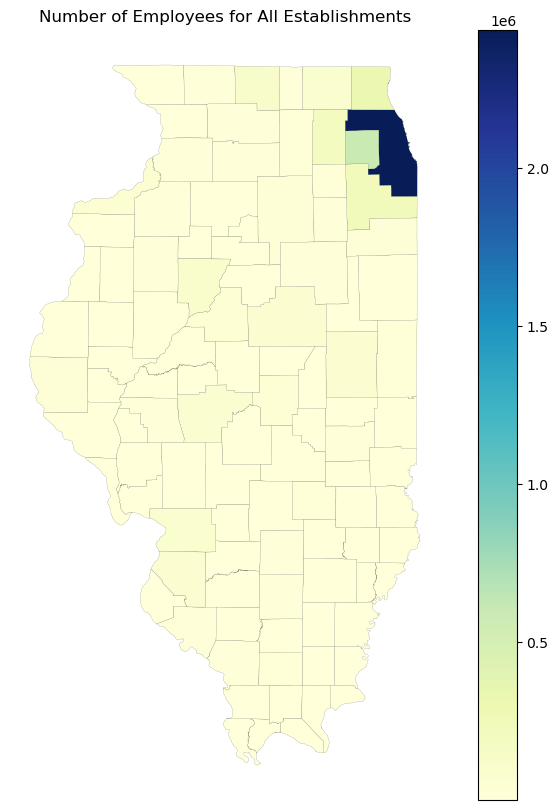

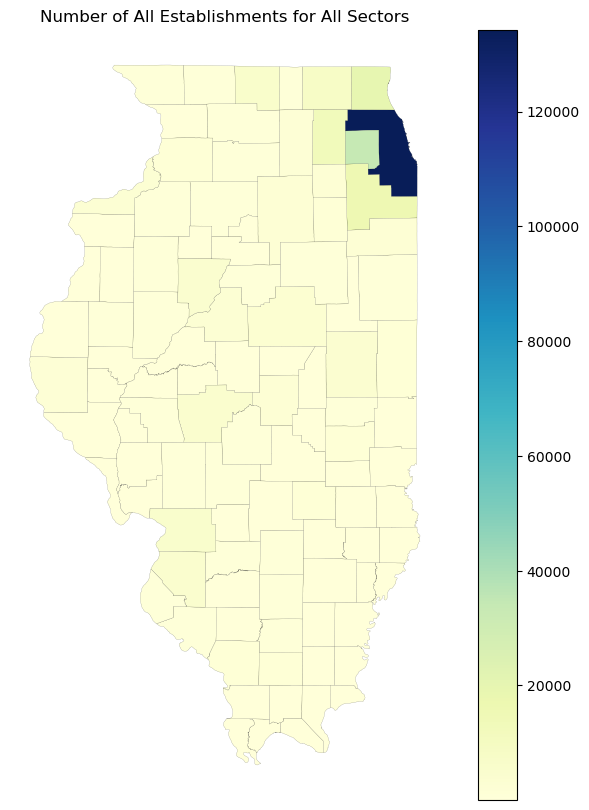

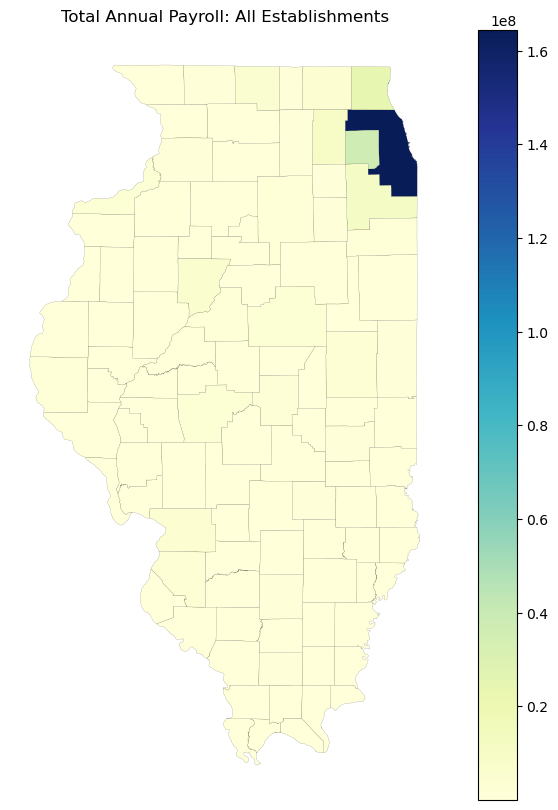

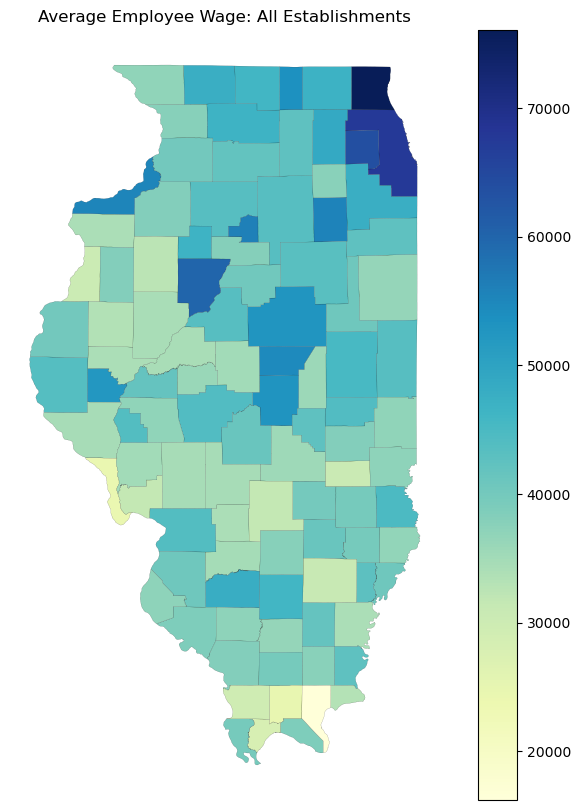

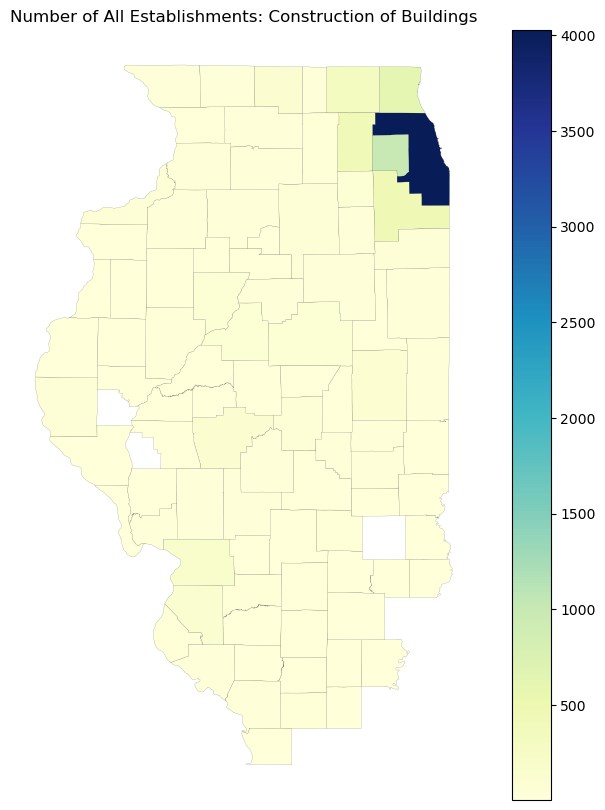

...

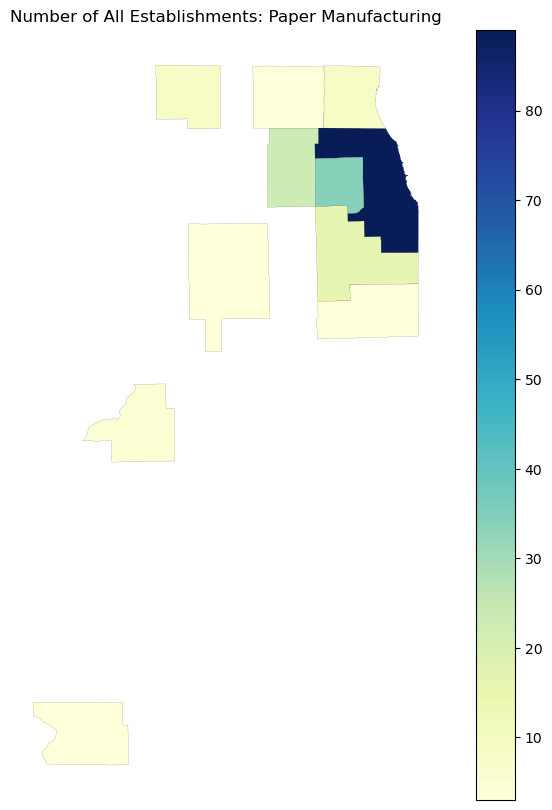

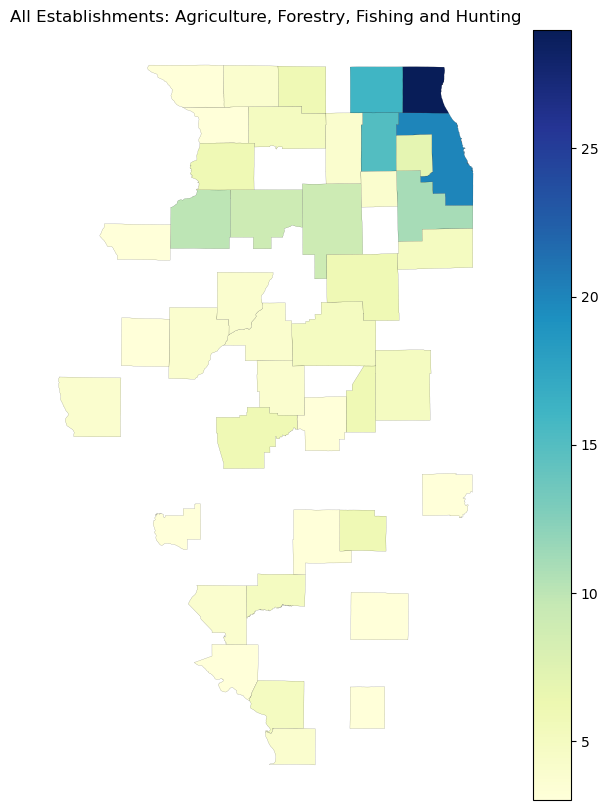

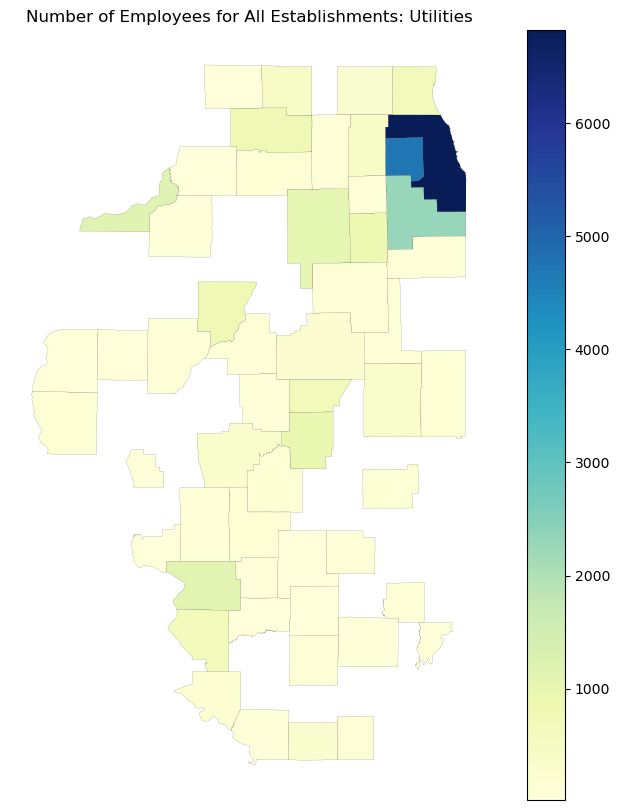

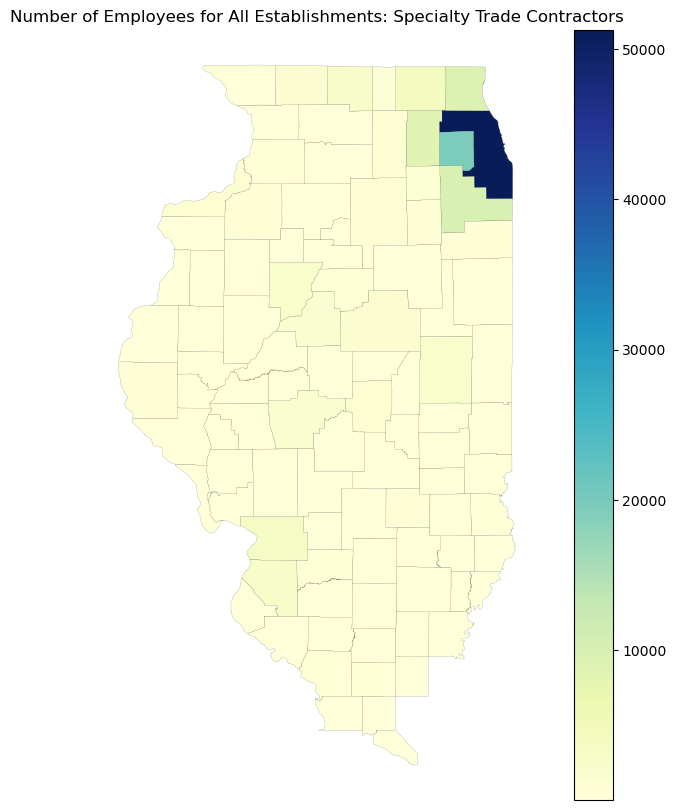

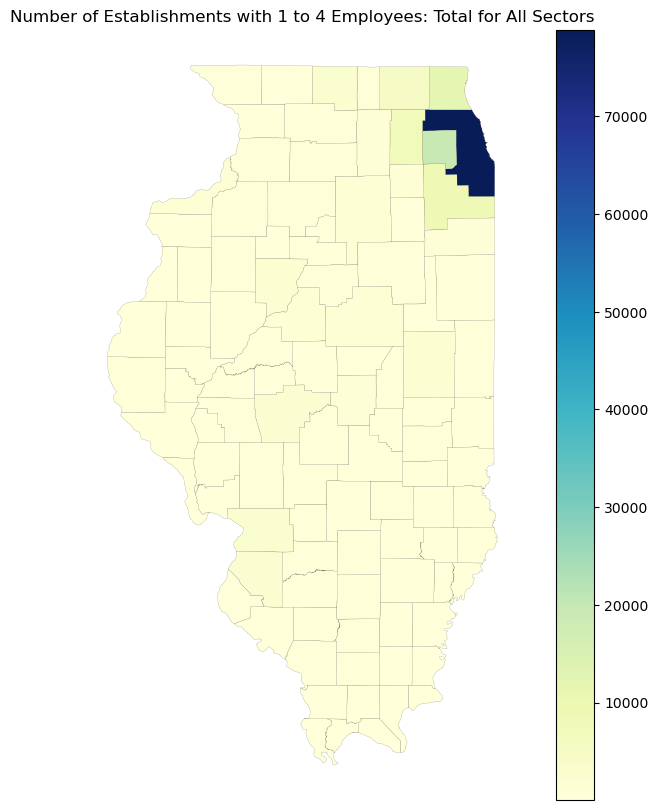

In [22]:
for col in cols:
    # Plot the heatmap of the 'population' column
    fig, ax = plt.subplots(figsize=(10, 10))

    merged_gdf.plot(column=col, cmap='YlGnBu', edgecolor='black', linewidth=0.08, ax=ax, legend=True)

    # Customize the plot
    ax.set_title(col)
    ax.axis('off')

    # Display the plot
    plt.show()

In [15]:
pip install ipywidgets

Note: you may need to restart the kernel to use updated packages.


In [23]:
import matplotlib.pyplot as plt
import ipywidgets as widgets
from IPython.display import display

In [33]:
def update_map(selected_column):
    fig, ax = plt.subplots(figsize=(10, 10))
    merged_gdf.plot(column=selected_column, cmap='YlGnBu', edgecolor='black', linewidth=0.08, ax=ax, legend=True)
    ax.set_title(selected_column)
    ax.axis('off')

In [34]:
available_columns = cols

In [35]:
# Create the dropdown widget
dropdown = widgets.Dropdown(
    options=available_columns,
    description='Select Variable:'
)

# Display the interactive map
interactive_map = widgets.interactive(update_map, selected_column=dropdown)
display(interactive_map)


interactive(children=(Dropdown(description='Select Variable:', options=('Number of Employees for All Establish…

In [43]:
# Save the interactive map as an HTML file
html = interactive_map.children[-2].get_root().render()
with open("interactive_map.html", "w") as f:
    f.write(html)

AttributeError: 'Dropdown' object has no attribute 'get_root'

### TRYING ANOTHER METHOD

In [36]:
from folium import plugins
import ipywidgets as widgets
from IPython.display import display

In [41]:
# Assuming you already have the 'merged_gdf' GeoDataFrame
# and the 'cols' list of available columns.

def plot_gdf_with_dropdown(gdf):
    # Get the centroid of the GeoDataFrame
    centroid = [gdf.centroid.y.mean(), gdf.centroid.x.mean()]

    # Create a Folium map centered around the centroid
    m = folium.Map(location=centroid, zoom_start=10)

    # Add GeoJSON layer to the map
    geojson = folium.GeoJson(gdf.to_json(), name='geojson')
    m.add_child(geojson)

    # Create a dropdown widget to select columns
    dropdown_widget = widgets.Dropdown(
        options=cols,
        description='Select column to plot:',
        disabled=False,
    )
    
    def on_change(change):
        column_name = change['new']
        if column_name is not None:
            layer = geojson.layer
            layer.options['style'] = lambda feature: {
                'fillColor': get_color(feature['properties'][column_name]),
                'color': 'black',
                'weight': 0.8,
                'fillOpacity': 0.5,
            }
            m.add_child(geojson)  # Update the map with the new colors
            
    def get_color(value):
        # Define the color scheme based on the selected column values
        if value > 0.5:
            return 'green'
        else:
            return 'red'
    
    # Attach the on_change function to the dropdown widget
    dropdown_widget.observe(on_change, names='value')

    # Display the map and dropdown widget
    display(m)
    display(dropdown_widget)

# Assuming you already have the 'merged_gdf' GeoDataFrame
plot_gdf_with_dropdown(merged_gdf)


C:\Users\user\AppData\Local\Temp\ipykernel_12104\1006884922.py:6: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroid = [gdf.centroid.y.mean(), gdf.centroid.x.mean()]


Dropdown(description='Select column to plot:', options=('Number of Employees for All Establishments', 'Number …

## REMOVING COOK COUNTY

In [147]:
from IPython.display import HTML
import json

In [54]:
merged_gdf_nocook = merged_gdf[merged_gdf['Name of Area'] != 'Cook County']


In [55]:
def update_map(selected_column):
    fig, ax = plt.subplots(figsize=(10, 10))
    merged_gdf_nocook.plot(column=selected_column, cmap='YlGnBu', edgecolor='black', linewidth=0.08, ax=ax, legend=True)
    ax.set_title(selected_column)
    ax.axis('off')

In [148]:
# Create the dropdown widget
dropdown = widgets.Dropdown(
    options=available_columns,
    description='Select Variable:'
)

# Display the interactive map
interactive_map = widgets.interactive(update_map, selected_column=dropdown)
display(interactive_map)


interactive(children=(Dropdown(description='Select Variable:', options=('Number of Employees for All Establish…

In [155]:
from IPython.display import HTML, display
import json
import matplotlib.pyplot as plt
import geopandas as gpd
import ipywidgets as widgets
from IPython.display import display as ipydisplay

available_columns =  ['Number of Employees for All Establishments', 'Number of All Establishments for All Sectors', 
        'Total Annual Payroll: All Establishments', 'Average Employee Wage: All Establishments', 
        'Number of All Establishments: Construction of Buildings', 'Number of All Establishments: Heavy and Civil Engineering Construction',
        'Number of All Establishments: Paper Manufacturing','All Establishments: Agriculture, Forestry, Fishing and Hunting',
       'Number of Employees for All Establishments: Utilities', 'Number of Employees for All Establishments: Specialty Trade Contractors',
        'Number of Establishments with 1 to 4 Employees: Total for All Sectors']

# Assuming you have a GeoDataFrame 'merged_gdf_nocook' defined
merged_gdf_nocook = merged_gdf[merged_gdf['Name of Area'] != 'Cook County']

def update_map(selected_column):
    fig, ax = plt.subplots(figsize=(10, 10))
    merged_gdf_nocook.plot(column=selected_column, cmap='YlGnBu', edgecolor='black', linewidth=0.08, ax=ax, legend=True)
    ax.set_title(selected_column)
    ax.axis('off')
    plt.close(fig)  # Close the figure to avoid displaying it inline
    return HTML(fig_to_html(fig))

def fig_to_html(fig):
    import io
    buf = io.BytesIO()
    fig.savefig(buf, format="png")
    data = base64.b64encode(buf.getbuffer()).decode("ascii")
    return f"<img src='data:image/png;base64,{data}'/>"

# Create the dropdown widget
dropdown = widgets.Dropdown(
    options=available_columns,
    description='Select Variable:'
)

# Display the interactive map
interactive_output = widgets.interactive_output(update_map, {'selected_column': dropdown})
ipydisplay(dropdown, interactive_output)

# Save the interactive map as an HTML file
html_template = f'''
<!DOCTYPE html>
<html>
<head>
    <title>Interactive Map</title>
    <script src="https://cdn.jsdelivr.net/npm/vega@5.20.2"></script>
    <script src="https://cdn.jsdelivr.net/npm/vega-lite@4.17.0"></script>
    <script src="https://cdn.jsdelivr.net/npm/vega-embed@6.3.3"></script>
</head>
<body>
    <h1>Interactive Map with Dropdown Options</h1>
    <h2>Select Variable:</h2>
    {dropdown._repr_html_()}
    {interactive_output._repr_html_()}
</body>
</html>
'''

# Save the HTML content to a file
with open('interactive_map.html_test', 'w') as f:
    f.write(html_template)


Dropdown(description='Select Variable:', options=('Number of Employees for All Establishments', 'Number of All…

Output()

AttributeError: 'Dropdown' object has no attribute '_repr_html_'

In [63]:
from shapely.geometry import Point
from folium.plugins import HeatMap


In [146]:
import folium
import pandas as pd
from folium.plugins import HeatMap
from shapely.geometry import Point

# Assuming your "merged_gdf" is a GeoDataFrame that contains the spatial data and columns you need

# Create a folium Map centered at a specific location (e.g., latitude and longitude)
map_center = [51.5074, -0.1278]  # London, UK
zoom_level = 10
map_object = folium.Map(location=map_center, zoom_start=zoom_level)

# Extract the unique values from the column you want to use for dropdown options
dropdown_values = cols

# Create a Dropdown control and add options to it
dropdown_options = ['<option value="{0}">{0}</option>'.format(value) for value in dropdown_values]
dropdown_html = f"""
<select id="dropdown">
  <option value="" disabled selected>Select an option</option>
  {"".join(dropdown_options)}
</select>
"""

# Add the dropdown to the map
dropdown_control = folium.Element(dropdown_html)
map_object.get_root().html.add_child(folium.Element(dropdown_html))

# Add an empty feature group to hold the heat map data
heatmap_group = folium.FeatureGroup(name="Heatmap")
map_object.add_child(heatmap_group)

# A global variable to store the heatmap data
heatmap_data = []

# Helper function to update the heatmap data based on the selected dropdown option
def update_heatmap_data(value):
    global heatmap_data
    heatmap_data = []
    for idx, row in merged_gdf[merged_gdf["Number of Employees for All Establishments"] == value].iterrows():
        if row["geometry"].geom_type == 'Point':
            latitude, longitude = row["geometry"].y, row["geometry"].x
        else:
            latitude, longitude = row["geometry"].centroid.y, row["geometry"].centroid.x

        # Add the location and heatmap_column value to the heatmap data
        heatmap_data.append([latitude, longitude, row["heatmap_column"]])

# JavaScript callback function to update the heatmap on dropdown change
callback_js = """
function(value, zoom) {
    // Clear previous heatmap layer
    heatmapLayer.clearLayers();
    // Update the heatmap data based on the selected dropdown value
    update_heatmap_data(value);
    // Create a new heatmap layer with updated data
    heatmapLayer = L.heatLayer(heatmap_data, {radius: 25, blur: 15}).addTo(map);
}
"""

# Add the JavaScript callback function to the map
map_object.get_root().html.add_child(folium.Element(f"<script>{callback_js}</script>"))

# Initial heatmap data based on the first dropdown option
update_heatmap_data(dropdown_values[0])

# Create the initial heatmap layer
heatmapLayer = HeatMap(heatmap_data, radius=25, blur=15).add_to(heatmap_group)

# Save the map as an HTML file
map_object.save("interactive_heatmap.html")


In [71]:
#variable of interest
cols = ['Number of Employees for All Establishments', 'Number of All Establishments for All Sectors', 
        'Total Annual Payroll: All Establishments', 'Average Employee Wage: All Establishments', 
        'Number of All Establishments: Construction of Buildings', 'Number of All Establishments: Heavy and Civil Engineering Construction',
        'Number of All Establishments: Paper Manufacturing','All Establishments: Agriculture, Forestry, Fishing and Hunting',
       'Number of Employees for All Establishments: Utilities', 'Number of Employees for All Establishments: Specialty Trade Contractors',
        'Number of Establishments with 1 to 4 Employees: Total for All Sectors']

In [85]:


# Assuming your "merged_gdf" is a GeoDataFrame that contains the spatial data and columns you need

# Create a folium Map centered at a specific location (e.g., latitude and longitude)
map_center = [41.8781, -87.6298]
zoom_level = 10
map_object = folium.Map(location=map_center, zoom_start=zoom_level)

# Extract the unique values from the column you want to use for dropdown options
dropdown_values = cols

# Create a Dropdown control and add options to it
dropdown_options = ['<option value="{0}">{0}</option>'.format(value) for value in dropdown_values]
dropdown_html = f"""
<select id="dropdown">
  <option value="" disabled selected>Select an option</option>
  {"".join(dropdown_options)}
</select>
"""

# Add the dropdown to the map
dropdown_control = folium.Element(dropdown_html)
map_object.get_root().html.add_child(folium.Element(dropdown_html))

# Add an empty feature group to hold the markers
marker_group = folium.FeatureGroup(name="Markers")
map_object.add_child(marker_group)

# Iterate through the GeoDataFrame and add markers to the map
for idx, row in merged_gdf.iterrows():
    # Extract latitude and longitude from the geometry column
    if row["geometry"].geom_type == 'Point':
        latitude, longitude = row["geometry"].y, row["geometry"].x
    else:
        # For other geometries like polygons, get the centroid coordinates
        latitude, longitude = row["geometry"].centroid.y, row["geometry"].centroid.x

    popup_content = f"Place Name: {row['Name of Area']}"  # Customize popup content
    popup = folium.Popup(popup_content, max_width=300)
    marker = folium.Marker(
        location=[latitude, longitude],
        popup=popup,
    )
    marker.add_to(marker_group)

# Save the map as an HTML file
map_object.save("interactive_map.html")
